# ML

We are going to look at the "unsupervised" portion of ML. Specifically, we will look at PCA and clustering.

## PCA

Principal Component Analysis (PCA) is a technique used to reduce the dimensionality of the data. It does this by finding the directions of maximum variance in the data and projecting the data onto these directions. The first principal component is the direction of maximum variance, the second principal component is the direction of maximum variance orthogonal to the first principal component, and so on.

We can use this to:

- Visualize high-dimensional data in 2D or 3D.
- Reduce the dimensionality of the data to make it easier to work with.
- Remove noise from the data.
- Find the most important features in the data.


## Loading the data

In [1]:
import pandas as pd

In [2]:

url = 'https://github.com/mattharrison/datasets/raw/refs/heads/master/data/vehicles.csv.zip'
raw_mpg = pd.read_csv(url)
raw_mpg

/var/folders/qn/r8_0pgj1645dn1w69vqls6cw0000gn/T/ipykernel_26176/3359993885.py:2: DtypeWarning: Columns (68,70,71,72,73,74,76,79) have mixed types. Specify dtype option on import or set low_memory=False.
  raw_mpg = pd.read_csv(url)


,barrels08,barrelsA08,charge120,charge240,city08,city08U,cityA08,cityA08U,cityCD,cityE,...,mfrCode,c240Dscr,charge240b,c240bDscr,createdOn,modifiedOn,startStop,phevCity,phevHwy,phevComb
0,15.695714,0.0,0.0,0.0,19,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
1,29.964545,0.0,0.0,0.0,9,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
2,12.207778,0.0,0.0,0.0,23,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
3,29.964545,0.0,0.0,0.0,10,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
4,17.347895,0.0,0.0,0.0,17,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41139,14.982273,0.0,0.0,0.0,19,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
41140,14.330870,0.0,0.0,0.0,20,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
41141,15.695714,0.0,0.0,0.0,18,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0
41142,15.695714,0.0,0.0,0.0,18,0.0,0,0.0,0.0,0.0,...,NaN,NaN,0.0,NaN,Tue Jan 01 00:00:00 EST 2013,Tue Jan 01 00:00:00 EST 2013,NaN,0,0,0


## Prepping the Data

Many ML algorithms require the data to be in a specific format. 

- Rows of the data are the samples.
- Columns of the data are the features.
- Data must be numerical.
- No missing values.
- Data must be scaled.

(These last three are not always true, but they are true for many algorithms.)

In [ ]:
columns = ['barrels08', 'city08', 'comb08', 'cylinders', 'displ', 'drive', 'fuelCost08', 'highway08', 'make', 'model', 'trany', 'VClass', 'year']
(raw_mpg
 #.select_dtypes(include='number')
 [columns]
 .describe()
)

,barrels08,city08,comb08,cylinders,displ,fuelCost08,highway08,year
count,41144.000000,41144.000000,41144.000000,40938.000000,40940.000000,41144.000000,41144.000000,41144.000000
mean,17.283900,18.369045,20.616396,5.717084,3.294238,2362.335942,24.504667,2001.535266
std,4.623232,7.905886,7.674535,1.755517,1.357151,654.981925,7.730364,11.142414
min,0.060000,6.000000,7.000000,2.000000,0.000000,500.000000,9.000000,1984.000000
25%,14.330870,15.000000,17.000000,4.000000,2.200000,1900.000000,20.000000,1991.000000
50%,16.480500,17.000000,20.000000,6.000000,3.000000,2350.000000,24.000000,2002.000000
75%,19.388824,20.000000,23.000000,6.000000,4.300000,2700.000000,28.000000,2011.000000
max,47.087143,150.000000,136.000000,16.000000,8.400000,7400.000000,124.000000,2020.000000


In [ ]:
# deal with missing values
# and split trany into speeds and manual

(raw_mpg
 [columns]
 .assign(cylinders=lambda df_: df_.cylinders.fillna(0),
         displ=lambda df_: df_.displ.fillna(0),
         speeds=lambda df_: df_.trany.str.extract(r'(\d+)').astype(float).fillna(0),
         manual=lambda df_: df_.trany.str.contains('Manual', case=False, na=False),
 )
)

,barrels08,city08,comb08,cylinders,displ,drive,fuelCost08,highway08,make,model,trany,VClass,year,speeds,manual
0,15.695714,19,21,4.0,2.0,Rear-Wheel Drive,2000,25,Alfa Romeo,Spider Veloce 2000,Manual 5-spd,Two Seaters,1985,5.0,True
1,29.964545,9,11,12.0,4.9,Rear-Wheel Drive,3850,14,Ferrari,Testarossa,Manual 5-spd,Two Seaters,1985,5.0,True
2,12.207778,23,27,4.0,2.2,Front-Wheel Drive,1550,33,Dodge,Charger,Manual 5-spd,Subcompact Cars,1985,5.0,True
3,29.964545,10,11,8.0,5.2,Rear-Wheel Drive,3850,12,Dodge,B150/B250 Wagon 2WD,Automatic 3-spd,Vans,1985,3.0,False
4,17.347895,17,19,4.0,2.2,4-Wheel or All-Wheel Drive,2700,23,Subaru,Legacy AWD Turbo,Manual 5-spd,Compact Cars,1993,5.0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41139,14.982273,19,22,4.0,2.2,Front-Wheel Drive,1900,26,Subaru,Legacy,Automatic 4-spd,Compact Cars,1993,4.0,False
41140,14.330870,20,23,4.0,2.2,Front-Wheel Drive,1850,28,Subaru,Legacy,Manual 5-spd,Compact Cars,1993,5.0,True
41141,15.695714,18,21,4.0,2.2,4-Wheel or All-Wheel Drive,2000,24,Subaru,Legacy AWD,Automatic 4-spd,Compact Cars,1993,4.0,False
41142,15.695714,18,21,4.0,2.2,4-Wheel or All-Wheel Drive,2000,24,Subaru,Legacy AWD,Manual 5-spd,Compact Cars,1993,5.0,True


In [32]:
# deal with missing values
# and split trany into speeds and manual
# dummy encode the drive, make, model, and VClass columns
# drop the trany column
final_cols = ['barrels08', 'city08', 'comb08', 'cylinders', 'displ', 'fuelCost08',
       'highway08', 'year', 'speeds', 'manual',
       'drive_Front-Wheel Drive', 'drive_Other', 'drive_Rear-Wheel Drive',
       'make_Dodge', 'make_Ford', 'make_Other', 'model_F150 Pickup 4WD',
       'model_Mustang', 'model_Other', 'VClass_Midsize Cars', 'VClass_Other',
       'VClass_Subcompact Cars']

def top_n(df, column, n=3):
    values = (df[column]
            .value_counts()
            .head(n)
            .index)
    return (df[column]
                .where(df[column].isin(values), 'Other')
    )

(raw_mpg
 [columns]
 .assign(cylinders=lambda df_: df_.cylinders.fillna(0),
         displ=lambda df_: df_.displ.fillna(0),
         speeds=lambda df_: df_.trany.str.extract(r'(\d+)').astype(float).fillna(0),
         manual=lambda df_: df_.trany.str.contains('Manual', case=False, na=False),
         drive=lambda df_: top_n(df_, 'drive'),
         make=lambda df_: top_n(df_, 'make'),
         model=lambda df_: top_n(df_, 'model'),
         VClass=lambda df_: top_n(df_, 'VClass'),
 )
 .pipe(pd.get_dummies, columns=['drive', 'make', 'model', 'VClass'], drop_first=True)
 .loc[:, final_cols]
)

,barrels08,city08,comb08,cylinders,displ,fuelCost08,highway08,year,speeds,manual,...,drive_Rear-Wheel Drive,make_Dodge,make_Ford,make_Other,model_F150 Pickup 4WD,model_Mustang,model_Other,VClass_Midsize Cars,VClass_Other,VClass_Subcompact Cars
0,15.695714,19,21,4.0,2.0,2000,25,1985,5.0,True,...,True,False,False,True,False,False,True,False,True,False
1,29.964545,9,11,12.0,4.9,3850,14,1985,5.0,True,...,True,False,False,True,False,False,True,False,True,False
2,12.207778,23,27,4.0,2.2,1550,33,1985,5.0,True,...,False,True,False,False,False,False,True,False,False,True
3,29.964545,10,11,8.0,5.2,3850,12,1985,3.0,False,...,True,True,False,False,False,False,True,False,True,False
4,17.347895,17,19,4.0,2.2,2700,23,1993,5.0,True,...,False,False,False,True,False,False,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41139,14.982273,19,22,4.0,2.2,1900,26,1993,4.0,False,...,False,False,False,True,False,False,True,False,False,False
41140,14.330870,20,23,4.0,2.2,1850,28,1993,5.0,True,...,False,False,False,True,False,False,True,False,False,False
41141,15.695714,18,21,4.0,2.2,2000,24,1993,4.0,False,...,False,False,False,True,False,False,True,False,False,False
41142,15.695714,18,21,4.0,2.2,2000,24,1993,5.0,True,...,False,False,False,True,False,False,True,False,False,False


In [42]:
# standardize the columns
# (x - mean) / std
final_cols = ['barrels08', 'city08', 'comb08', 'cylinders', 'displ', 'fuelCost08',
       'highway08', 'year', 'speeds', 'manual',
       'drive_Front-Wheel Drive', 'drive_Other', 'drive_Rear-Wheel Drive',
       'make_Dodge', 'make_Ford', 'make_Other', 'model_F150 Pickup 4WD',
       'model_Mustang', 'model_Other', 'VClass_Midsize Cars', 'VClass_Other',
       'VClass_Subcompact Cars']

def top_n(df, column, n=3):
    values = (df[column]
            .value_counts()
            .head(n)
            .index)
    return (df[column]
                .where(df[column].isin(values), 'Other')
    )

X = (raw_mpg
 [columns]
 .assign(cylinders=lambda df_: df_.cylinders.fillna(0),
         displ=lambda df_: df_.displ.fillna(0),
         speeds=lambda df_: df_.trany.str.extract(r'(\d+)').astype(float).fillna(0),
         manual=lambda df_: df_.trany.str.contains('Manual', case=False, na=False),
         drive=lambda df_: top_n(df_, 'drive'),
         make=lambda df_: top_n(df_, 'make'),
         model=lambda df_: top_n(df_, 'model'),
         VClass=lambda df_: top_n(df_, 'VClass'),
 )
 .pipe(pd.get_dummies, columns=['drive', 'make', 'model', 'VClass'], drop_first=True)
 .loc[:, final_cols]
 .pipe(lambda df_: (df_ - df_.mean(axis='index')) / df_.std(axis='index'))
)

X

,barrels08,city08,comb08,cylinders,displ,fuelCost08,highway08,year,speeds,manual,...,drive_Rear-Wheel Drive,make_Dodge,make_Ford,make_Other,model_F150 Pickup 4WD,model_Mustang,model_Other,VClass_Midsize Cars,VClass_Other,VClass_Subcompact Cars
0,-0.343523,0.079808,0.049984,-0.939595,-0.930458,-0.553200,0.064076,-1.483993,0.053734,1.487300,...,1.405247,-0.258811,-0.298733,0.565031,-0.069538,-0.068471,0.122673,-0.365893,0.793582,-0.378464
1,2.742810,-1.185072,-1.253027,3.512247,1.181067,2.271306,-1.358884,-1.483993,0.053734,1.487300,...,1.405247,-0.258811,-0.298733,0.565031,-0.069538,-0.068471,0.122673,-0.365893,0.793582,-0.378464
2,-1.097960,0.585760,0.831790,-0.939595,-0.784835,-1.240242,1.098956,-1.483993,0.053734,1.487300,...,-0.711601,3.863729,-0.298733,-1.769772,-0.069538,-0.068471,0.122673,-0.365893,-1.260078,2.642197
3,2.742810,-1.058584,-1.253027,1.286326,1.399501,2.271306,-1.617604,-1.483993,-1.259498,-0.672343,...,1.405247,3.863729,-0.298733,-1.769772,-0.069538,-0.068471,0.122673,-0.365893,0.793582,-0.378464
4,0.013842,-0.173168,-0.210618,-0.939595,-0.784835,0.515532,-0.194644,-0.766016,0.053734,1.487300,...,-0.711601,-0.258811,-0.298733,0.565031,-0.069538,-0.068471,0.122673,-0.365893,-1.260078,-0.378464
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41139,-0.497839,0.079808,0.180285,-0.939595,-0.784835,-0.705876,0.193436,-0.766016,-0.602882,-0.672343,...,-0.711601,-0.258811,-0.298733,0.565031,-0.069538,-0.068471,0.122673,-0.365893,-1.260078,-0.378464
41140,-0.638737,0.206296,0.310586,-0.939595,-0.784835,-0.782214,0.452156,-0.766016,0.053734,1.487300,...,-0.711601,-0.258811,-0.298733,0.565031,-0.069538,-0.068471,0.122673,-0.365893,-1.260078,-0.378464
41141,-0.343523,-0.046680,0.049984,-0.939595,-0.784835,-0.553200,-0.065284,-0.766016,-0.602882,-0.672343,...,-0.711601,-0.258811,-0.298733,0.565031,-0.069538,-0.068471,0.122673,-0.365893,-1.260078,-0.378464
41142,-0.343523,-0.046680,0.049984,-0.939595,-0.784835,-0.553200,-0.065284,-0.766016,0.053734,1.487300,...,-0.711601,-0.258811,-0.298733,0.565031,-0.069538,-0.068471,0.122673,-0.365893,-1.260078,-0.378464


In [43]:
X.describe()

,barrels08,city08,comb08,cylinders,displ,fuelCost08,highway08,year,speeds,manual,...,drive_Rear-Wheel Drive,make_Dodge,make_Ford,make_Other,model_F150 Pickup 4WD,model_Mustang,model_Other,VClass_Midsize Cars,VClass_Other,VClass_Subcompact Cars
count,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,...,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04,4.114400e+04
mean,7.030477e-16,-2.935842e-18,1.313357e-16,8.980221e-18,3.699160e-16,-1.726966e-17,-3.764785e-17,-5.446159e-15,1.001640e-16,3.868403e-17,...,7.598649e-18,1.295224e-19,2.348673e-17,-1.710991e-16,1.286589e-17,4.317414e-19,3.727655e-16,-3.073999e-17,-1.941109e-16,8.220356e-17
std,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,...,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
min,-3.725511e+00,-1.564536e+00,-1.774231e+00,-3.165516e+00,-2.386682e+00,-2.843339e+00,-2.005684e+00,-1.573740e+00,-3.229345e+00,-6.723428e-01,...,-7.116014e-01,-2.588110e-01,-2.987331e-01,-1.769772e+00,-6.953790e-02,-6.847117e-02,-8.151538e+00,-3.658929e-01,-1.260078e+00,-3.784636e-01
25%,-6.387372e-01,-4.261439e-01,-4.712202e-01,-9.395946e-01,-7.848353e-01,-7.058759e-01,-5.827237e-01,-9.455102e-01,-6.028819e-01,-6.723428e-01,...,-7.116014e-01,-2.588110e-01,-2.987331e-01,5.650309e-01,-6.953790e-02,-6.847117e-02,1.226733e-01,-3.658929e-01,-1.260078e+00,-3.784636e-01
50%,-1.737745e-01,-1.731678e-01,-8.031706e-02,1.733658e-01,-2.023456e-01,-1.883402e-02,-6.528367e-02,4.170852e-02,5.373384e-02,-6.723428e-01,...,-7.116014e-01,-2.588110e-01,-2.987331e-01,5.650309e-01,-6.953790e-02,-6.847117e-02,1.226733e-01,-3.658929e-01,7.935822e-01,-3.784636e-01
75%,4.552927e-01,2.062963e-01,3.105861e-01,1.733658e-01,7.442002e-01,5.155319e-01,4.521564e-01,8.494330e-01,7.103496e-01,1.487300e+00,...,1.405247e+00,-2.588110e-01,-2.987331e-01,5.650309e-01,-6.953790e-02,-6.847117e-02,1.226733e-01,-3.658929e-01,7.935822e-01,-3.784636e-01
max,6.446409e+00,1.664974e+01,1.503460e+01,5.738168e+00,3.729460e+00,7.691302e+00,1.287072e+01,1.657157e+00,3.336813e+00,1.487300e+00,...,1.405247e+00,3.863729e+00,3.347388e+00,5.650309e-01,1.438030e+01,1.460433e+01,1.226733e-01,2.732974e+00,7.935822e-01,2.642197e+00


## PCA Visualization

https://builtin.com/data-science/step-step-explanation-principal-component-analysis

<img src='https://builtin.com/sites/www.builtin.com/files/inline-images/national/Principal%2520Component%2520Analysis%2520second%2520principal.gif'>

## PCA

Here are the steps to perform PCA:

1. Center the data. (Often, we also standardize the data.)
2. Compute the covariance matrix.
3. Compute the eigenvectors and eigenvalues of the covariance matrix.
4. Sort the eigenvectors by their eigenvalues.
5. Project the data onto the top k eigenvectors.

In [ ]:
import numpy as np

centered = X - X.mean(axis='index') # 1
vals, vec = np.linalg.eig(centered.cov()) # 2 & 3
idxs = pd.Series(vals).argsort() #4

explained_variance = pd.Series(vals[idxs], 
                               index=[f'PC{i+1}' for i in range(len(X.columns))]) 
def set_columns(df_):
    df_.columns = [f'PC{i+1}' for i in range(len(X.columns))]
    return df_

comps = (pd.DataFrame(vec, index=X.columns)
         .iloc[:, idxs[::-1]]
         .pipe(set_columns)
)

pcas = (centered @ comps) # 5
pcas

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22
0,-0.491964,-0.220950,-0.887880,-0.352072,2.269284,0.181247,0.444206,-0.806629,0.624822,1.304889,...,-0.080595,-0.477266,-0.185969,0.270706,0.101221,0.152993,0.030396,-0.061937,-0.038882,0.031383
1,5.193616,0.499418,-1.077530,0.853467,1.192902,0.342614,0.722573,-0.403573,0.803477,0.662113,...,0.140736,-0.775763,0.266683,0.451078,0.187033,0.505697,1.182420,-1.036923,-0.089292,-0.036248
2,-2.733625,-2.372286,-2.449716,0.114988,-0.189039,0.927262,-3.799075,-0.241931,1.556213,-1.525766,...,-0.154749,-0.591179,-0.286862,0.673651,0.141299,-0.277711,-0.083599,0.158662,-0.184588,-0.028558
3,5.185700,-1.161540,-2.443103,-1.591658,-0.954415,1.617187,-1.327034,0.781781,1.278514,-0.815023,...,0.926595,-0.279354,0.299401,0.068430,-0.052754,0.587782,-0.042928,-0.277727,-0.021079,-0.045828
4,-0.430497,-0.015060,-0.999386,0.809853,0.982961,-0.918566,-0.239289,-0.540726,0.514685,0.943693,...,0.864845,0.059316,0.546737,-1.213749,-0.042940,-0.677370,-0.004468,0.309015,0.012069,0.024813
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41139,-1.807508,-0.207192,-1.238026,0.364738,-0.422835,-0.851376,0.631484,0.304038,-0.651078,-0.474546,...,0.001813,-0.700827,0.765524,-0.551868,-0.054440,-0.001665,-0.251628,0.003379,0.048104,-0.038902
41140,-2.171753,-0.317184,-1.210749,0.656949,0.495040,-0.983062,-0.090802,-1.004271,-0.017738,0.264242,...,-0.122479,-0.536183,0.821038,-0.417871,-0.026099,0.030732,-0.271992,0.026594,0.025010,-0.000953
41141,-1.011916,0.003232,-0.830492,0.286785,0.112262,-0.589486,0.489962,0.748604,-0.118528,0.242709,...,0.332696,-0.246381,0.507944,-1.068396,0.130951,-1.129503,-0.139792,-0.032014,-0.018321,-0.071009
41142,-1.117362,-0.095380,-0.883899,0.647638,1.020356,-0.838694,-0.259534,-0.588403,0.454971,0.977444,...,0.254524,-0.019794,0.568715,-0.956578,0.136976,-1.058451,-0.185789,-0.061282,0.054651,-0.070301


## PCA with sklearn

In [101]:
from sklearn.decomposition import PCA

pca = PCA()
pca.fit(X)

PCA()

In [88]:
pcas = pd.DataFrame(pca.transform(X), index=X.index).pipe(set_columns)
pcas

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22
0,0.491964,0.220950,-0.887880,-0.352072,-2.269284,0.181247,0.444206,-0.806629,0.624822,-1.304889,...,-0.080595,-0.477266,-0.185969,0.270706,-0.101221,0.152993,0.030396,-0.061937,0.038882,0.031383
1,-5.193616,-0.499418,-1.077530,0.853467,-1.192902,0.342614,0.722573,-0.403573,0.803477,-0.662113,...,0.140736,-0.775763,0.266683,0.451078,-0.187033,0.505697,1.182420,-1.036923,0.089292,-0.036248
2,2.733625,2.372286,-2.449716,0.114988,0.189039,0.927262,-3.799075,-0.241931,1.556213,1.525766,...,-0.154749,-0.591179,-0.286862,0.673651,-0.141299,-0.277711,-0.083599,0.158662,0.184588,-0.028558
3,-5.185700,1.161540,-2.443103,-1.591658,0.954415,1.617187,-1.327034,0.781781,1.278514,0.815023,...,0.926595,-0.279354,0.299401,0.068430,0.052754,0.587782,-0.042928,-0.277727,0.021079,-0.045828
4,0.430497,0.015060,-0.999386,0.809853,-0.982961,-0.918566,-0.239289,-0.540726,0.514685,-0.943693,...,0.864845,0.059316,0.546737,-1.213749,0.042940,-0.677370,-0.004468,0.309015,-0.012069,0.024813
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41139,1.807508,0.207192,-1.238026,0.364738,0.422835,-0.851376,0.631484,0.304038,-0.651078,0.474546,...,0.001813,-0.700827,0.765524,-0.551868,0.054440,-0.001665,-0.251628,0.003379,-0.048104,-0.038902
41140,2.171753,0.317184,-1.210749,0.656949,-0.495040,-0.983062,-0.090802,-1.004271,-0.017738,-0.264242,...,-0.122479,-0.536183,0.821038,-0.417871,0.026099,0.030732,-0.271992,0.026594,-0.025010,-0.000953
41141,1.011916,-0.003232,-0.830492,0.286785,-0.112262,-0.589486,0.489962,0.748604,-0.118528,-0.242709,...,0.332696,-0.246381,0.507944,-1.068396,-0.130951,-1.129503,-0.139792,-0.032014,0.018321,-0.071009
41142,1.117362,0.095380,-0.883899,0.647638,-1.020356,-0.838694,-0.259534,-0.588403,0.454971,-0.977444,...,0.254524,-0.019794,0.568715,-0.956578,-0.136976,-1.058451,-0.185789,-0.061282,-0.054651,-0.070301


In [85]:
comps = pd.DataFrame(pca.components_, columns=X.columns,
                     index=[f'PC{i+1}' for i in range(len(X.columns))])
comps

,barrels08,city08,comb08,cylinders,displ,fuelCost08,highway08,year,speeds,manual,...,drive_Rear-Wheel Drive,make_Dodge,make_Ford,make_Other,model_F150 Pickup 4WD,model_Mustang,model_Other,VClass_Midsize Cars,VClass_Other,VClass_Subcompact Cars
PC1,-0.367633,0.331329,0.348147,-0.327456,-0.338601,-0.352220,0.358842,0.064458,-0.026148,0.056776,...,-0.169855,-0.063900,-0.052089,0.104667,-0.045107,-0.014697,0.057959,0.065055,-0.173933,0.081612
PC2,0.009864,0.032791,0.022264,-0.087723,-0.043847,-0.068928,0.001776,-0.272356,-0.259446,0.124543,...,0.018569,0.122722,0.416041,-0.382865,0.301912,0.335609,-0.472257,-0.052454,-0.058455,0.134898
PC3,-0.091989,0.116842,0.124608,0.101914,0.091065,-0.016503,0.137014,0.484483,0.410051,-0.149401,...,0.032707,-0.211119,0.210177,0.022166,0.229715,0.232647,-0.334288,-0.049831,0.124358,-0.071747
PC4,0.007363,-0.175819,-0.143021,0.095278,0.000269,0.084137,-0.078489,-0.010097,0.186676,0.110333,...,0.066552,-0.240059,-0.139749,0.324690,-0.006712,0.275797,-0.151529,0.248057,-0.543132,0.474226
PC5,0.024744,-0.032109,-0.020987,0.137597,0.131317,0.018700,0.007454,0.160822,-0.041229,-0.407948,...,-0.252839,0.238698,0.094946,-0.219160,0.073826,-0.086512,0.009868,0.615511,-0.280485,-0.217821
PC6,-0.026081,0.246689,0.233422,0.152087,0.169156,0.046185,0.215501,0.137410,-0.015332,-0.110732,...,0.596602,0.217629,-0.012818,-0.190273,-0.342791,0.162061,0.109670,0.099107,-0.087047,0.106622
PC7,0.038329,0.108941,0.084206,0.049847,0.057351,0.044831,0.043602,-0.059089,-0.322828,-0.248894,...,0.194419,-0.506815,-0.027046,0.353685,0.264299,-0.086693,-0.145415,0.137324,0.116227,-0.301537
PC8,0.080756,0.158641,0.114749,0.048288,0.071248,0.069202,0.039971,-0.223673,-0.458159,-0.479789,...,-0.142115,-0.037066,-0.112228,0.093149,-0.114578,0.165609,-0.011054,-0.133945,-0.045209,0.296280
PC9,0.057958,0.184858,0.161788,0.040436,0.058004,0.112868,0.124302,-0.133048,0.001247,0.265174,...,0.135934,0.312056,-0.332750,0.064670,0.553935,-0.347079,-0.110959,0.162276,-0.119028,0.061707
PC10,-0.002494,-0.022800,-0.011404,0.094181,0.056915,0.027916,0.008105,0.295236,0.062780,-0.359299,...,-0.100386,0.249553,-0.218220,0.018408,0.268055,-0.120160,-0.055366,-0.460295,0.052177,0.343356


## Explained Variance

The explained variance tells us how much of the variance in the data is explained by each principal component. We can use this to determine how many principal components to keep.

In [98]:
pca.explained_variance_ratio_

array([2.89807219e-01, 1.03974429e-01, 8.82670514e-02, 7.15771909e-02,
       6.32442323e-02, 5.89423568e-02, 5.35700876e-02, 4.67134851e-02,
       4.30818694e-02, 4.01501724e-02, 3.78800508e-02, 2.94161327e-02,
       1.42728336e-02, 1.32271409e-02, 1.15909332e-02, 1.04375145e-02,
       8.85868448e-03, 7.39562119e-03, 3.90673036e-03, 2.25863905e-03,
       1.35649448e-03, 7.11311729e-05])

<AxesSubplot: >

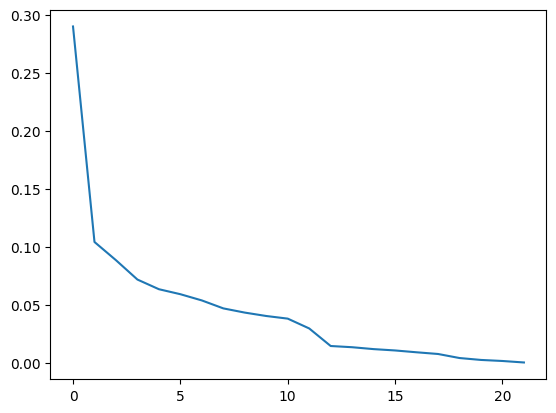

In [99]:
pd.Series(pca.explained_variance_ratio_).plot()

<AxesSubplot: >

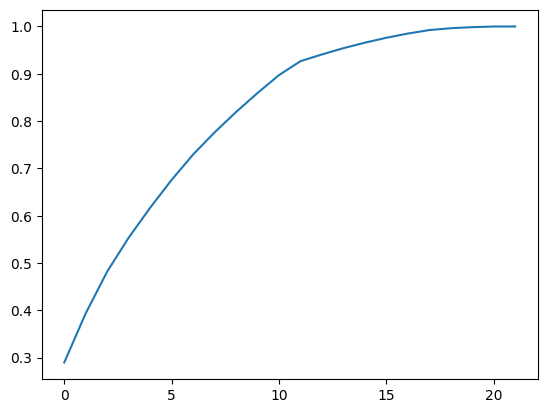

In [100]:
pd.Series(pca.explained_variance_ratio_).cumsum().plot()

## Visualizing Comps

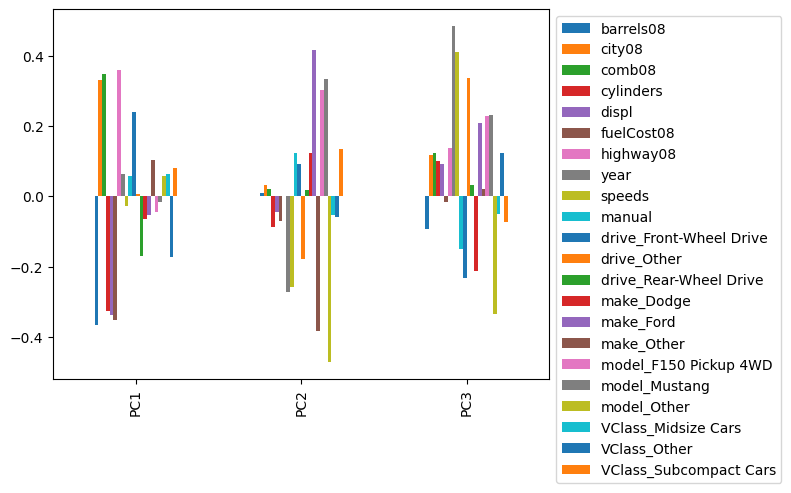

In [ ]:
(comps
.loc[:'PC3', lambda df: (df.abs() > .1).any(axis='index')]
.plot.bar()
.legend(bbox_to_anchor=(1,1))              
)

## Visualizing Data

<AxesSubplot: xlabel='PC1', ylabel='PC2'>

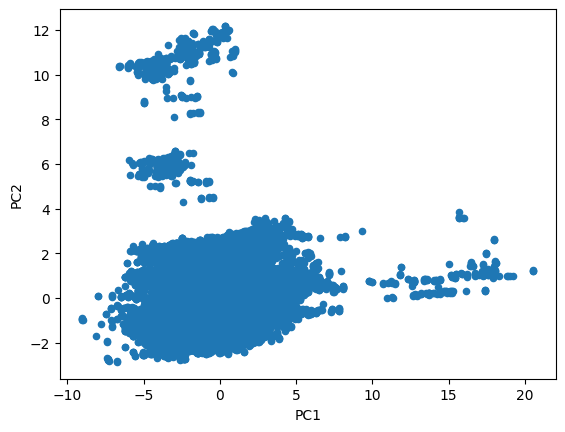

In [91]:
(pcas
 .assign(**raw_mpg)
 .plot.scatter(x='PC1', y='PC2')
)

<AxesSubplot: xlabel='PC1', ylabel='PC2'>

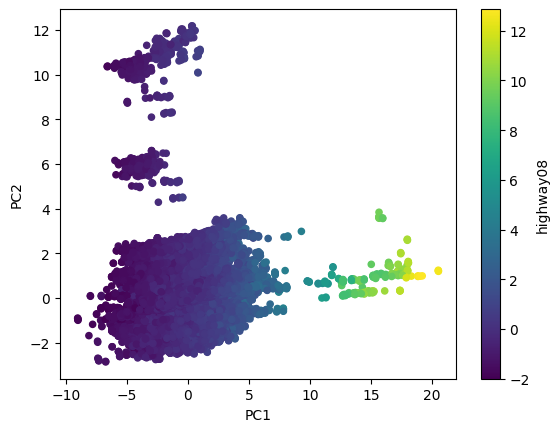

In [94]:
(pcas
 .assign(**X)
 .plot.scatter(x='PC1', y='PC2',
               c='highway08',
                cmap='viridis')
)

<AxesSubplot: xlabel='PC1', ylabel='PC2'>

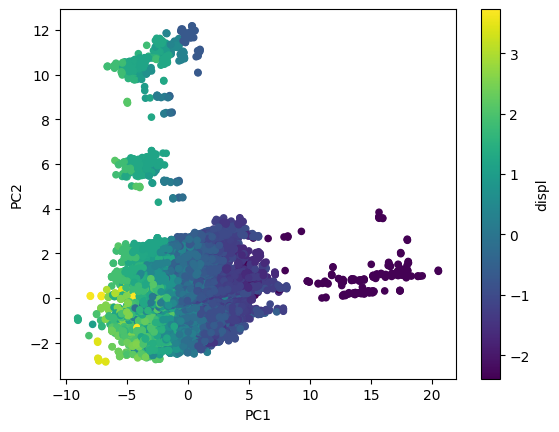

In [96]:
(pcas
 .assign(**X)
 .plot.scatter(x='PC1', y='PC2',
               #c='make_Ford',
                c='displ',
                cmap='viridis')
)

## 3D Visualization

In [110]:
import plotly.express as px

fig = px.scatter_3d(data:=pcas
                        .loc[:, :'PC3']
                        .assign(**raw_mpg[columns],
                                      is_tesla=raw_mpg.make == 'Tesla',
                                      ), x='PC1', y='PC2', z='PC3',
                    #color='cylinders',
                    color='is_tesla',
                    hover_data=data.columns,
                    color_continuous_scale='viridis')

fig.update_layout(width=800, height=800, title='PCA')
fig.update_traces(marker=dict(size=3))
fig.show()

## Clustering

Clustering is the process of grouping similar data points together. There are many different clustering algorithms, but the most common is k-means clustering.

In [111]:
# run kmeans on X
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5)
kmeans.fit(X)
labels = kmeans.predict(X)
labels

array([1, 4, 3, ..., 1, 1, 1], dtype=int32)

### Visualizing Clusters


In [ ]:
import plotly.express as px

fig = px.scatter_3d(data:=pcas
                        .loc[:, :'PC3']
                        .assign(**raw_mpg[columns],
                                      is_tesla=raw_mpg.make == 'Tesla',
                                        cluster=labels
                                      ), x='PC1', y='PC2', z='PC3',
                    #color='cylinders',
                    color='cluster',
                    hover_data=data.columns,
                    color_continuous_scale='viridis')

fig.update_layout(width=800, height=800, title='Showing Clusters on PCA Data')
fig.update_traces(marker=dict(size=3))
fig.show()

## How Many Clusters?

<AxesSubplot: >

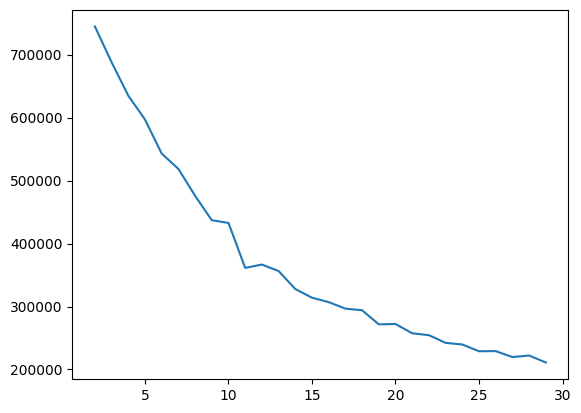

In [115]:
# We are going to track "inertia" which is the sum of squared distances of samples to their closest cluster center.
scores = []

ks = range(2, 30)

for k in ks:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    scores.append(kmeans.inertia_)

pd.Series(scores, index=ks).plot()

## Understanding Clusters

In [122]:
k = 11
kmeans = KMeans(n_clusters=k)
kmeans.fit(X)
labels = kmeans.predict(X)


(raw_mpg
 [columns]
 .assign(cluster=labels)
    .groupby('cluster')
    .mean(numeric_only=True)
)

,barrels08,city08,comb08,cylinders,displ,fuelCost08,highway08,year
cluster,,,,,,,,
0,22.719238,13.134487,14.915080,7.991347,5.138912,3127.978986,18.106675,2000.168850
1,17.563830,17.033739,19.094493,5.240724,2.971165,2406.376812,22.577043,1999.493681
2,0.205556,106.343915,101.248677,NaN,0.000000,667.195767,96.365079,2015.523810
3,14.232078,21.316502,23.951232,4.562592,2.199310,1975.800493,28.391379,1997.122906
4,17.099057,16.786458,19.520833,6.593750,4.039062,2232.812500,24.484375,2000.755208
5,13.995460,21.647031,24.353440,4.529974,2.309028,1856.956880,28.941918,2002.702757
6,23.678495,12.939394,14.222222,7.171717,4.822222,3048.232323,16.388889,1996.691919
7,15.076272,20.180882,22.926225,5.296078,2.879314,2073.835784,27.800490,2003.291912
8,20.786682,14.905076,16.775898,6.321915,4.027239,2725.856376,20.043335,1995.771771


In [123]:
(raw_mpg
 [columns]
 .assign(cluster=labels)
 .groupby('cluster')
 .mean(numeric_only=True)
 .style.background_gradient(cmap='RdBu', axis='index')
)

,barrels08,city08,comb08,cylinders,displ,fuelCost08,highway08,year
cluster,,,,,,,,
0,22.719238,13.134487,14.915080,7.991347,5.138912,3127.978986,18.106675,2000.168850
1,17.563830,17.033739,19.094493,5.240724,2.971165,2406.376812,22.577043,1999.493681
2,0.205556,106.343915,101.248677,nan,0.000000,667.195767,96.365079,2015.523810
3,14.232078,21.316502,23.951232,4.562592,2.199310,1975.800493,28.391379,1997.122906
4,17.099057,16.786458,19.520833,6.593750,4.039062,2232.812500,24.484375,2000.755208
5,13.995460,21.647031,24.353440,4.529974,2.309028,1856.956880,28.941918,2002.702757
6,23.678495,12.939394,14.222222,7.171717,4.822222,3048.232323,16.388889,1996.691919
7,15.076272,20.180882,22.926225,5.296078,2.879314,2073.835784,27.800490,2003.291912
8,20.786682,14.905076,16.775898,6.321915,4.027239,2725.856376,20.043335,1995.771771


## Hierchical Clustering

In [124]:
from scipy.cluster import hierarchy
from sklearn import cluster

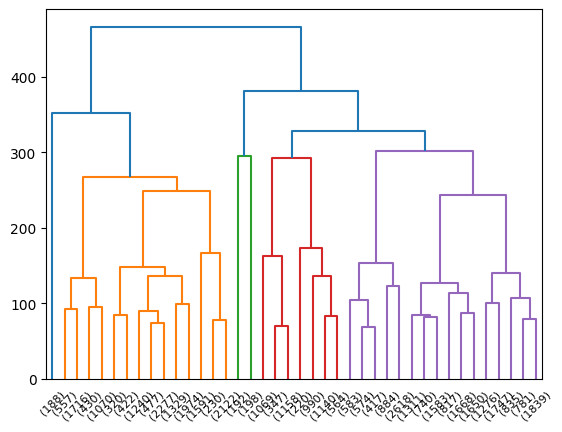

In [ ]:
# takes 2 minutes!
dend = hierarchy.dendrogram(hierarchy.linkage(X, method='ward'),
                            truncate_mode='lastp',
                            p=40
                            )

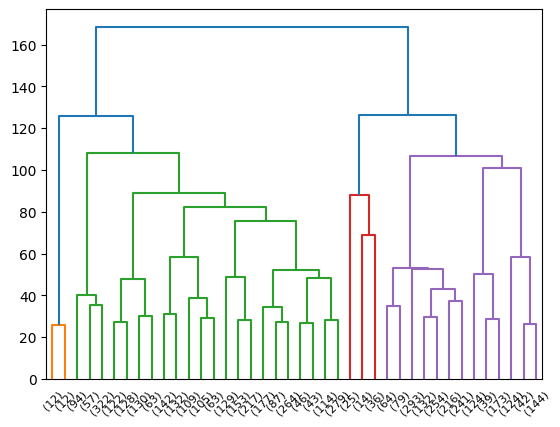

In [ ]:

dend = hierarchy.dendrogram(hierarchy.linkage(X.sample(5_000), method='ward'),
                            truncate_mode='lastp',
                            p=40
                            )

In [130]:
agg = cluster.AgglomerativeClustering(n_clusters=10, linkage='ward')
agg.fit(X.sample(5_000))

AgglomerativeClustering(n_clusters=10)

In [131]:
agg.labels_

array([0, 0, 8, ..., 0, 0, 0])